In [1]:
from google.colab import drive

In [3]:
drive.mount('/content/drive')

Mounted at /content/drive


In [7]:
ls /content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset

images/  labels/  labels2/


In [8]:
!apt-get install libcairo2-dev
!pip install super_gradients
import os
import shutil
import random
from tqdm.notebook import tqdm
from super_gradients.training import dataloaders
from super_gradients.training.dataloaders.dataloaders import coco_detection_yolo_format_train, coco_detection_yolo_format_val
import torch
from super_gradients.training import models
from super_gradients.training.losses import PPYoloELoss
from super_gradients.training.metrics import DetectionMetrics_050
from super_gradients.training.models.detection_models.pp_yolo_e import PPYoloEPostPredictionCallback
from super_gradients.training import Trainer

Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
The following additional packages will be installed:
  libblkid-dev libcairo-script-interpreter2 libffi-dev libglib2.0-dev libglib2.0-dev-bin libice-dev
  liblzo2-2 libmount-dev libpixman-1-dev libselinux1-dev libsepol-dev libsm-dev libxcb-render0-dev
  libxcb-shm0-dev
Suggested packages:
  libcairo2-doc libgirepository1.0-dev libglib2.0-doc libgdk-pixbuf2.0-bin | libgdk-pixbuf2.0-dev
  libxml2-utils libice-doc libsm-doc
The following NEW packages will be installed:
  libblkid-dev libcairo-script-interpreter2 libcairo2-dev libffi-dev libglib2.0-dev
  libglib2.0-dev-bin libice-dev liblzo2-2 libmount-dev libpixman-1-dev libselinux1-dev libsepol-dev
  libsm-dev libxcb-render0-dev libxcb-shm0-dev
0 upgraded, 15 newly installed, 0 to remove and 11 not upgraded.
Need to get 3,839 kB of archives.
After this operation, 19.8 MB of additional disk space will be used.
Get:1 http://archive.ubuntu.com/u

[2023-11-28 16:30:26] INFO - crash_tips_setup.py - Crash tips is enabled. You can set your environment variable to CRASH_HANDLER=FALSE to disable it


The console stream is logged into /root/sg_logs/console.log


[2023-11-28 16:30:26] WARNING - __init__.py - Failed to import pytorch_quantization
[2023-11-28 16:30:26] INFO - utils.py - NumExpr defaulting to 2 threads.
[2023-11-28 16:30:34] WARNING - calibrator.py - Failed to import pytorch_quantization
[2023-11-28 16:30:34] WARNING - export.py - Failed to import pytorch_quantization
[2023-11-28 16:30:34] WARNING - selective_quantization_utils.py - Failed to import pytorch_quantization
[2023-11-28 16:30:34] WARNING - env_sanity_check.py - Failed to verify installed packages: boto3 required but not found
[2023-11-28 16:30:34] WARNING - env_sanity_check.py - Failed to verify installed packages: deprecated required but not found
[2023-11-28 16:30:34] WARNING - env_sanity_check.py - Failed to verify installed packages: coverage required but not found
[2023-11-28 16:30:34] WARNING - env_sanity_check.py - Failed to verify installed packages: sphinx-rtd-theme required but not found
[2023-11-28 16:30:34] WARNING - env_sanity_check.py - Failed to verify i

In [9]:
dataset_params = {
    'data_dir':'/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset',
    'train_images_dir':'/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/images/train',
    'train_labels_dir':'/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/labels/train',
    'val_images_dir':'/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/images/val',
    'val_labels_dir':'/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/labels/val',
    'test_images_dir':'/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/images/val',
    'test_labels_dir':'/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/labels/val',
    'classes': ['face']
}

In [10]:
MODEL_ARCH = 'yolo_nas_l'
DEVICE = 'cuda' if torch.cuda.is_available() else "cpu"
BATCH_SIZE = 8
MAX_EPOCHS = 16
CHECKPOINT_DIR = f'/kaggle/working/'
EXPERIMENT_NAME = f'yolo_nas_face'

In [11]:
train_data = coco_detection_yolo_format_train(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['train_images_dir'],
        'labels_dir': dataset_params['train_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size': BATCH_SIZE,
        'num_workers': 1
    }
)

val_data = coco_detection_yolo_format_val(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['val_images_dir'],
        'labels_dir': dataset_params['val_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size': BATCH_SIZE,
        'num_workers': 1
    }
)

test_data = coco_detection_yolo_format_val(
    dataset_params={
        'data_dir': dataset_params['data_dir'],
        'images_dir': dataset_params['test_images_dir'],
        'labels_dir': dataset_params['test_labels_dir'],
        'classes': dataset_params['classes']
    },
    dataloader_params={
        'batch_size': BATCH_SIZE,
        'num_workers': 1
    }
)

[2023-11-28 16:32:30] WARNING - yolo_format_detection.py - 1167 images are note associated to any label file
[2023-11-28 16:32:30] WARNING - yolo_format_detection.py - 2559 label files are not associated to any image.
[2023-11-28 16:32:30] WARNING - yolo_format_detection.py - As a consequence, 1113/2280 images and 1113/3672 label files will be used.
[2023-11-28 16:32:30] INFO - detection_dataset.py - Dataset Initialization in progress. `cache_annotations=True` causes the process to take longer due to full dataset indexing.
Indexing dataset annotations: 100%|██████████| 1113/1113 [04:26<00:00,  4.18it/s]
[2023-11-28 16:37:02] WARNING - yolo_format_detection.py - 792 label files are not associated to any image.
[2023-11-28 16:37:02] INFO - detection_dataset.py - Dataset Initialization in progress. `cache_annotations=True` causes the process to take longer due to full dataset indexing.
Indexing dataset annotations: 100%|██████████| 564/564 [02:03<00:00,  4.56it/s]
[2023-11-28 16:39:05] WA

In [12]:
train_data.dataset.transforms

[DetectionMosaic('additional_samples_count': 3, 'non_empty_targets': False, 'prob': 1.0, 'input_dim': (640, 640), 'enable_mosaic': True, 'border_value': 114),
 DetectionRandomAffine('additional_samples_count': 0, 'non_empty_targets': False, 'degrees': 10.0, 'translate': 0.1, 'scale': [0.1, 2], 'shear': 2.0, 'target_size': (640, 640), 'enable': True, 'filter_box_candidates': True, 'wh_thr': 2, 'ar_thr': 20, 'area_thr': 0.1, 'border_value': 114),
 DetectionMixup('additional_samples_count': 1, 'non_empty_targets': True, 'input_dim': (640, 640), 'mixup_scale': [0.5, 1.5], 'prob': 1.0, 'enable_mixup': True, 'flip_prob': 0.5, 'border_value': 114),
 DetectionHSV('additional_samples_count': 0, 'non_empty_targets': False, 'prob': 1.0, 'hgain': 5, 'sgain': 30, 'vgain': 30, 'bgr_channels': (0, 1, 2), '_additional_channels_warned': False),
 DetectionHorizontalFlip('additional_samples_count': 0, 'non_empty_targets': False, 'prob': 0.5),
 DetectionPaddedRescale('additional_samples_count': 0, 'non_em

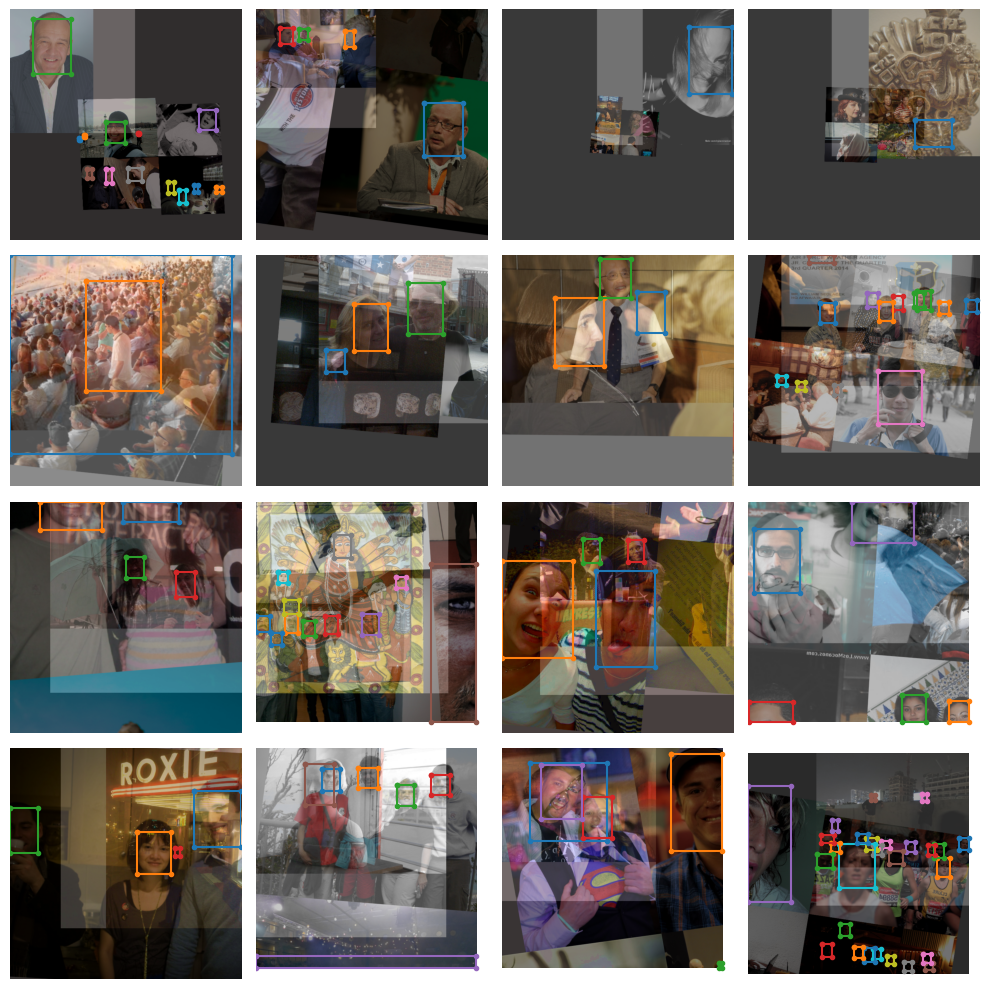

In [13]:
train_data.dataset.plot()

In [14]:
model = models.get(
    MODEL_ARCH,
    num_classes=len(dataset_params['classes']),
    pretrained_weights="coco"
)

[2023-11-28 16:40:32] INFO - checkpoint_utils.py - License Notification: YOLO-NAS pre-trained weights are subjected to the specific license terms and conditions detailed in 
https://github.com/Deci-AI/super-gradients/blob/master/LICENSE.YOLONAS.md
By downloading the pre-trained weight files you agree to comply with these terms.
Downloading: "https://sghub.deci.ai/models/yolo_nas_l_coco.pth" to /root/.cache/torch/hub/checkpoints/yolo_nas_l_coco.pth
100%|██████████| 256M/256M [00:00<00:00, 269MB/s]
[2023-11-28 16:40:34] INFO - checkpoint_utils.py - Successfully loaded pretrained weights for architecture yolo_nas_l


In [17]:
# Ajustando a taxa de aprendizado inicial e outros parâmetros de otimização
train_params = {
    'silent_mode': False,
    "average_best_models":True,
    "warmup_mode": "LinearBatchLRWarmup",
    "warmup_initial_lr": 1e-6,
    "lr_warmup_epochs": 5, # Aumentei para mais épocas de warmup para um ajuste mais suave
    "initial_lr": 1e-3, # Reduzi um pouco a taxa de aprendizado inicial para uma convergência mais estável
    "lr_mode": "CosineLRScheduler",
    "cosine_final_lr_ratio": 0.1,
    "optimizer": "AdamW", # Alterei essa configuração
    "optimizer_params": {"weight_decay": 0.0001}, # Ajuste de peso da regularização L2 (weight decay)
    "zero_weight_decay_on_bias_and_bn": True,
    "ema": True,
    "ema_params": {"decay": 0.9997, "decay_type": "exp", "beta": 15}, # Ajustei parâmetros do EMA para EXP
    "max_epochs": MAX_EPOCHS,
    "mixed_precision": True,
    "loss": PPYoloELoss(
        use_static_assigner=False,
        num_classes=len(dataset_params['classes']),
        reg_max=16 # Mantive pq alterando para maior o treinamento não seguia
        ),
    "valid_metrics_list": [
        DetectionMetrics_050(
            score_thres=0.1,
            top_k_predictions=300,
            num_cls=len(dataset_params['classes']),
            normalize_targets=True,
            post_prediction_callback=PPYoloEPostPredictionCallback(
                score_threshold=0.01,
                nms_top_k=1000,
                max_predictions=300,
                nms_threshold=0.5, # # Reduzi a threshold do NMS para uma detecção mais suave e aumentar a detecção de objetos menores


            )
        )
    ],
    "metric_to_watch": 'mAP@0.50'
}



In [18]:
trainer = Trainer(experiment_name=EXPERIMENT_NAME, ckpt_root_dir=CHECKPOINT_DIR)


In [19]:
try:
    trainer.train(model=model,
              training_params=train_params,
              train_loader=train_data,
              valid_loader=val_data)
except Exception as e:
    print(f"Ocorreu um erro durante o treinamento: {e}")

[2023-11-28 17:12:29] INFO - sg_trainer.py - Starting a new run with `run_id=RUN_20231128_171229_486917`
[2023-11-28 17:12:29] INFO - sg_trainer.py - Checkpoints directory: /kaggle/working/yolo_nas_face/RUN_20231128_171229_486917
[2023-11-28 17:12:29] INFO - sg_trainer.py - Using EMA with params {'decay': 0.9997, 'decay_type': 'exp', 'beta': 15}


The console stream is now moved to /kaggle/working/yolo_nas_face/RUN_20231128_171229_486917/console_Nov28_17_12_29.txt


[2023-11-28 17:12:32] INFO - sg_trainer_utils.py - TRAINING PARAMETERS:
    - Mode:                         Single GPU
    - Number of GPUs:               1          (1 available on the machine)
    - Full dataset size:            1113       (len(train_set))
    - Batch size per GPU:           8          (batch_size)
    - Batch Accumulate:             1          (batch_accumulate)
    - Total batch size:             8          (num_gpus * batch_size)
    - Effective Batch size:         8          (num_gpus * batch_size * batch_accumulate)
    - Iterations per epoch:         139        (len(train_loader))
    - Gradient updates per epoch:   139        (len(train_loader) / batch_accumulate)
    - Model: YoloNAS_L  (66.91M parameters, 66.91M optimized)
    - Learning Rates and Weight Decays:
      - default: (66.91M parameters). LR: 0.001 (66.91M parameters) WD: 0.0, (84.69K parameters), WD: 0.0001, (66.82M parameters)

[2023-11-28 17:12:32] INFO - sg_trainer.py - Started training for 16

SUMMARY OF EPOCH 0
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.2153
│   ├── Ppyoloeloss/loss_iou = 0.8412
│   ├── Ppyoloeloss/loss_dfl = 0.7942
│   └── Ppyoloeloss/loss = 2.8506
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.1902
    ├── Ppyoloeloss/loss_iou = 0.7353
    ├── Ppyoloeloss/loss_dfl = 0.7607
    ├── Ppyoloeloss/loss = 2.6862
    ├── Precision@0.50 = 0.0416
    ├── Recall@0.50 = 0.5312
    ├── Map@0.50 = 0.2435
    └── F1@0.50 = 0.0772



Validating epoch 1: 100%|██████████| 71/71 [00:28<00:00,  2.48it/s]
[2023-11-28 17:20:35] INFO - base_sg_logger.py - Checkpoint saved in /kaggle/working/yolo_nas_face/RUN_20231128_171229_486917/ckpt_best.pth
[2023-11-28 17:20:35] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.47149476408958435


SUMMARY OF EPOCH 1
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.086
│   │   ├── Epoch N-1      = 1.2153 (↘ -0.1293)
│   │   └── Best until now = 1.2153 (↘ -0.1293)
│   ├── Ppyoloeloss/loss_iou = 0.7145
│   │   ├── Epoch N-1      = 0.8412 (↘ -0.1267)
│   │   └── Best until now = 0.8412 (↘ -0.1267)
│   ├── Ppyoloeloss/loss_dfl = 0.706
│   │   ├── Epoch N-1      = 0.7942 (↘ -0.0881)
│   │   └── Best until now = 0.7942 (↘ -0.0881)
│   └── Ppyoloeloss/loss = 2.5065
│       ├── Epoch N-1      = 2.8506 (↘ -0.3441)
│       └── Best until now = 2.8506 (↘ -0.3441)
└── Validation
    ├── Ppyoloeloss/loss_cls = 1.2379
    │   ├── Epoch N-1      = 1.1902 (↗ 0.0477)
    │   └── Best until now = 1.1902 (↗ 0.0477)
    ├── Ppyoloeloss/loss_iou = 0.631
    │   ├── Epoch N-1      = 0.7353 (↘ -0.1043)
    │   └── Best until now = 0.7353 (↘ -0.1043)
    ├── Ppyoloeloss/loss_dfl = 0.6498
    │   ├── Epoch N-1      = 0.7607 (↘ -0.1109)
    │   └── Best until now = 0.7607 (↘ -0.1109)
    ├── Ppyoloeloss/loss = 

Validating epoch 2: 100%|██████████| 71/71 [00:28<00:00,  2.51it/s]
[2023-11-28 17:24:31] INFO - base_sg_logger.py - Checkpoint saved in /kaggle/working/yolo_nas_face/RUN_20231128_171229_486917/ckpt_best.pth
[2023-11-28 17:24:31] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.545361340045929


SUMMARY OF EPOCH 2
├── Train
│   ├── Ppyoloeloss/loss_cls = 1.0416
│   │   ├── Epoch N-1      = 1.086  (↘ -0.0444)
│   │   └── Best until now = 1.086  (↘ -0.0444)
│   ├── Ppyoloeloss/loss_iou = 0.6773
│   │   ├── Epoch N-1      = 0.7145 (↘ -0.0372)
│   │   └── Best until now = 0.7145 (↘ -0.0372)
│   ├── Ppyoloeloss/loss_dfl = 0.6781
│   │   ├── Epoch N-1      = 0.706  (↘ -0.028)
│   │   └── Best until now = 0.706  (↘ -0.028)
│   └── Ppyoloeloss/loss = 2.397
│       ├── Epoch N-1      = 2.5065 (↘ -0.1096)
│       └── Best until now = 2.5065 (↘ -0.1096)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9771
    │   ├── Epoch N-1      = 1.2379 (↘ -0.2608)
    │   └── Best until now = 1.1902 (↘ -0.2132)
    ├── Ppyoloeloss/loss_iou = 0.5786
    │   ├── Epoch N-1      = 0.631  (↘ -0.0524)
    │   └── Best until now = 0.631  (↘ -0.0524)
    ├── Ppyoloeloss/loss_dfl = 0.6041
    │   ├── Epoch N-1      = 0.6498 (↘ -0.0457)
    │   └── Best until now = 0.6498 (↘ -0.0457)
    ├── Ppyoloeloss/loss 

Validating epoch 3: 100%|██████████| 71/71 [00:29<00:00,  2.41it/s]
[2023-11-28 17:28:41] INFO - base_sg_logger.py - Checkpoint saved in /kaggle/working/yolo_nas_face/RUN_20231128_171229_486917/ckpt_best.pth
[2023-11-28 17:28:41] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.6141063570976257


SUMMARY OF EPOCH 3
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9996
│   │   ├── Epoch N-1      = 1.0416 (↘ -0.0421)
│   │   └── Best until now = 1.0416 (↘ -0.0421)
│   ├── Ppyoloeloss/loss_iou = 0.6418
│   │   ├── Epoch N-1      = 0.6773 (↘ -0.0354)
│   │   └── Best until now = 0.6773 (↘ -0.0354)
│   ├── Ppyoloeloss/loss_dfl = 0.6489
│   │   ├── Epoch N-1      = 0.6781 (↘ -0.0292)
│   │   └── Best until now = 0.6781 (↘ -0.0292)
│   └── Ppyoloeloss/loss = 2.2903
│       ├── Epoch N-1      = 2.397  (↘ -0.1067)
│       └── Best until now = 2.397  (↘ -0.1067)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9245
    │   ├── Epoch N-1      = 0.9771 (↘ -0.0526)
    │   └── Best until now = 0.9771 (↘ -0.0526)
    ├── Ppyoloeloss/loss_iou = 0.5474
    │   ├── Epoch N-1      = 0.5786 (↘ -0.0312)
    │   └── Best until now = 0.5786 (↘ -0.0312)
    ├── Ppyoloeloss/loss_dfl = 0.5747
    │   ├── Epoch N-1      = 0.6041 (↘ -0.0294)
    │   └── Best until now = 0.6041 (↘ -0.0294)
    ├── Ppyoloeloss/lo

Validating epoch 4: 100%|██████████| 71/71 [00:27<00:00,  2.57it/s]
[2023-11-28 17:32:39] INFO - base_sg_logger.py - Checkpoint saved in /kaggle/working/yolo_nas_face/RUN_20231128_171229_486917/ckpt_best.pth
[2023-11-28 17:32:39] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.6465718746185303


SUMMARY OF EPOCH 4
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9793
│   │   ├── Epoch N-1      = 0.9996 (↘ -0.0202)
│   │   └── Best until now = 0.9996 (↘ -0.0202)
│   ├── Ppyoloeloss/loss_iou = 0.6254
│   │   ├── Epoch N-1      = 0.6418 (↘ -0.0164)
│   │   └── Best until now = 0.6418 (↘ -0.0164)
│   ├── Ppyoloeloss/loss_dfl = 0.6296
│   │   ├── Epoch N-1      = 0.6489 (↘ -0.0193)
│   │   └── Best until now = 0.6489 (↘ -0.0193)
│   └── Ppyoloeloss/loss = 2.2343
│       ├── Epoch N-1      = 2.2903 (↘ -0.056)
│       └── Best until now = 2.2903 (↘ -0.056)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9181
    │   ├── Epoch N-1      = 0.9245 (↘ -0.0064)
    │   └── Best until now = 0.9245 (↘ -0.0064)
    ├── Ppyoloeloss/loss_iou = 0.5339
    │   ├── Epoch N-1      = 0.5474 (↘ -0.0135)
    │   └── Best until now = 0.5474 (↘ -0.0135)
    ├── Ppyoloeloss/loss_dfl = 0.5585
    │   ├── Epoch N-1      = 0.5747 (↘ -0.0162)
    │   └── Best until now = 0.5747 (↘ -0.0162)
    ├── Ppyoloeloss/loss

Validating epoch 5: 100%|██████████| 71/71 [00:29<00:00,  2.43it/s]
[2023-11-28 17:36:54] INFO - base_sg_logger.py - Checkpoint saved in /kaggle/working/yolo_nas_face/RUN_20231128_171229_486917/ckpt_best.pth
[2023-11-28 17:36:54] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.6561350226402283


SUMMARY OF EPOCH 5
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9715
│   │   ├── Epoch N-1      = 0.9793 (↘ -0.0078)
│   │   └── Best until now = 0.9793 (↘ -0.0078)
│   ├── Ppyoloeloss/loss_iou = 0.6162
│   │   ├── Epoch N-1      = 0.6254 (↘ -0.0092)
│   │   └── Best until now = 0.6254 (↘ -0.0092)
│   ├── Ppyoloeloss/loss_dfl = 0.6213
│   │   ├── Epoch N-1      = 0.6296 (↘ -0.0084)
│   │   └── Best until now = 0.6296 (↘ -0.0084)
│   └── Ppyoloeloss/loss = 2.209
│       ├── Epoch N-1      = 2.2343 (↘ -0.0253)
│       └── Best until now = 2.2343 (↘ -0.0253)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.9054
    │   ├── Epoch N-1      = 0.9181 (↘ -0.0127)
    │   └── Best until now = 0.9181 (↘ -0.0127)
    ├── Ppyoloeloss/loss_iou = 0.5277
    │   ├── Epoch N-1      = 0.5339 (↘ -0.0062)
    │   └── Best until now = 0.5339 (↘ -0.0062)
    ├── Ppyoloeloss/loss_dfl = 0.5537
    │   ├── Epoch N-1      = 0.5585 (↘ -0.0048)
    │   └── Best until now = 0.5585 (↘ -0.0048)
    ├── Ppyoloeloss/los

Validating epoch 6: 100%|██████████| 71/71 [00:29<00:00,  2.44it/s]
[2023-11-28 17:41:23] INFO - base_sg_logger.py - Checkpoint saved in /kaggle/working/yolo_nas_face/RUN_20231128_171229_486917/ckpt_best.pth
[2023-11-28 17:41:23] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.6672553420066833


SUMMARY OF EPOCH 6
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.956
│   │   ├── Epoch N-1      = 0.9715 (↘ -0.0156)
│   │   └── Best until now = 0.9715 (↘ -0.0156)
│   ├── Ppyoloeloss/loss_iou = 0.6027
│   │   ├── Epoch N-1      = 0.6162 (↘ -0.0135)
│   │   └── Best until now = 0.6162 (↘ -0.0135)
│   ├── Ppyoloeloss/loss_dfl = 0.614
│   │   ├── Epoch N-1      = 0.6213 (↘ -0.0073)
│   │   └── Best until now = 0.6213 (↘ -0.0073)
│   └── Ppyoloeloss/loss = 2.1727
│       ├── Epoch N-1      = 2.209  (↘ -0.0363)
│       └── Best until now = 2.209  (↘ -0.0363)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.893
    │   ├── Epoch N-1      = 0.9054 (↘ -0.0124)
    │   └── Best until now = 0.9054 (↘ -0.0124)
    ├── Ppyoloeloss/loss_iou = 0.5206
    │   ├── Epoch N-1      = 0.5277 (↘ -0.0071)
    │   └── Best until now = 0.5277 (↘ -0.0071)
    ├── Ppyoloeloss/loss_dfl = 0.5487
    │   ├── Epoch N-1      = 0.5537 (↘ -0.0049)
    │   └── Best until now = 0.5537 (↘ -0.0049)
    ├── Ppyoloeloss/loss 

Validating epoch 7: 100%|██████████| 71/71 [00:28<00:00,  2.45it/s]
[2023-11-28 17:46:04] INFO - base_sg_logger.py - Checkpoint saved in /kaggle/working/yolo_nas_face/RUN_20231128_171229_486917/ckpt_best.pth
[2023-11-28 17:46:04] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.678104817867279


SUMMARY OF EPOCH 7
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.928
│   │   ├── Epoch N-1      = 0.956  (↘ -0.028)
│   │   └── Best until now = 0.956  (↘ -0.028)
│   ├── Ppyoloeloss/loss_iou = 0.5923
│   │   ├── Epoch N-1      = 0.6027 (↘ -0.0104)
│   │   └── Best until now = 0.6027 (↘ -0.0104)
│   ├── Ppyoloeloss/loss_dfl = 0.5957
│   │   ├── Epoch N-1      = 0.614  (↘ -0.0183)
│   │   └── Best until now = 0.614  (↘ -0.0183)
│   └── Ppyoloeloss/loss = 2.116
│       ├── Epoch N-1      = 2.1727 (↘ -0.0567)
│       └── Best until now = 2.1727 (↘ -0.0567)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8836
    │   ├── Epoch N-1      = 0.893  (↘ -0.0094)
    │   └── Best until now = 0.893  (↘ -0.0094)
    ├── Ppyoloeloss/loss_iou = 0.5178
    │   ├── Epoch N-1      = 0.5206 (↘ -0.0027)
    │   └── Best until now = 0.5206 (↘ -0.0027)
    ├── Ppyoloeloss/loss_dfl = 0.5458
    │   ├── Epoch N-1      = 0.5487 (↘ -0.0029)
    │   └── Best until now = 0.5487 (↘ -0.0029)
    ├── Ppyoloeloss/loss =

Validating epoch 8: 100%|██████████| 71/71 [00:32<00:00,  2.20it/s]
[2023-11-28 17:51:14] INFO - base_sg_logger.py - Checkpoint saved in /kaggle/working/yolo_nas_face/RUN_20231128_171229_486917/ckpt_best.pth
[2023-11-28 17:51:14] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.6826047897338867


SUMMARY OF EPOCH 8
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9304
│   │   ├── Epoch N-1      = 0.928  (↗ 0.0024)
│   │   └── Best until now = 0.928  (↗ 0.0024)
│   ├── Ppyoloeloss/loss_iou = 0.5754
│   │   ├── Epoch N-1      = 0.5923 (↘ -0.0169)
│   │   └── Best until now = 0.5923 (↘ -0.0169)
│   ├── Ppyoloeloss/loss_dfl = 0.5936
│   │   ├── Epoch N-1      = 0.5957 (↘ -0.002)
│   │   └── Best until now = 0.5957 (↘ -0.002)
│   └── Ppyoloeloss/loss = 2.0994
│       ├── Epoch N-1      = 2.116  (↘ -0.0166)
│       └── Best until now = 2.116  (↘ -0.0166)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8793
    │   ├── Epoch N-1      = 0.8836 (↘ -0.0043)
    │   └── Best until now = 0.8836 (↘ -0.0043)
    ├── Ppyoloeloss/loss_iou = 0.5165
    │   ├── Epoch N-1      = 0.5178 (↘ -0.0014)
    │   └── Best until now = 0.5178 (↘ -0.0014)
    ├── Ppyoloeloss/loss_dfl = 0.544
    │   ├── Epoch N-1      = 0.5458 (↘ -0.0018)
    │   └── Best until now = 0.5458 (↘ -0.0018)
    ├── Ppyoloeloss/loss = 

Validating epoch 9: 100%|██████████| 71/71 [00:29<00:00,  2.40it/s]
[2023-11-28 17:56:25] INFO - base_sg_logger.py - Checkpoint saved in /kaggle/working/yolo_nas_face/RUN_20231128_171229_486917/ckpt_best.pth
[2023-11-28 17:56:25] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.6862289309501648


SUMMARY OF EPOCH 9
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.9156
│   │   ├── Epoch N-1      = 0.9304 (↘ -0.0148)
│   │   └── Best until now = 0.928  (↘ -0.0124)
│   ├── Ppyoloeloss/loss_iou = 0.5725
│   │   ├── Epoch N-1      = 0.5754 (↘ -0.0028)
│   │   └── Best until now = 0.5754 (↘ -0.0028)
│   ├── Ppyoloeloss/loss_dfl = 0.5834
│   │   ├── Epoch N-1      = 0.5936 (↘ -0.0102)
│   │   └── Best until now = 0.5936 (↘ -0.0102)
│   └── Ppyoloeloss/loss = 2.0715
│       ├── Epoch N-1      = 2.0994 (↘ -0.0279)
│       └── Best until now = 2.0994 (↘ -0.0279)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8725
    │   ├── Epoch N-1      = 0.8793 (↘ -0.0068)
    │   └── Best until now = 0.8793 (↘ -0.0068)
    ├── Ppyoloeloss/loss_iou = 0.5154
    │   ├── Epoch N-1      = 0.5165 (↘ -0.0011)
    │   └── Best until now = 0.5165 (↘ -0.0011)
    ├── Ppyoloeloss/loss_dfl = 0.5421
    │   ├── Epoch N-1      = 0.544  (↘ -0.0019)
    │   └── Best until now = 0.544  (↘ -0.0019)
    ├── Ppyoloeloss/lo

Validating epoch 10: 100%|██████████| 71/71 [00:29<00:00,  2.41it/s]
[2023-11-28 18:01:19] INFO - base_sg_logger.py - Checkpoint saved in /kaggle/working/yolo_nas_face/RUN_20231128_171229_486917/ckpt_best.pth
[2023-11-28 18:01:19] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.6889380216598511


SUMMARY OF EPOCH 10
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8893
│   │   ├── Epoch N-1      = 0.9156 (↘ -0.0262)
│   │   └── Best until now = 0.9156 (↘ -0.0262)
│   ├── Ppyoloeloss/loss_iou = 0.5599
│   │   ├── Epoch N-1      = 0.5725 (↘ -0.0126)
│   │   └── Best until now = 0.5725 (↘ -0.0126)
│   ├── Ppyoloeloss/loss_dfl = 0.5611
│   │   ├── Epoch N-1      = 0.5834 (↘ -0.0223)
│   │   └── Best until now = 0.5834 (↘ -0.0223)
│   └── Ppyoloeloss/loss = 2.0103
│       ├── Epoch N-1      = 2.0715 (↘ -0.0612)
│       └── Best until now = 2.0715 (↘ -0.0612)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8681
    │   ├── Epoch N-1      = 0.8725 (↘ -0.0043)
    │   └── Best until now = 0.8725 (↘ -0.0043)
    ├── Ppyoloeloss/loss_iou = 0.5146
    │   ├── Epoch N-1      = 0.5154 (↘ -0.0008)
    │   └── Best until now = 0.5154 (↘ -0.0008)
    ├── Ppyoloeloss/loss_dfl = 0.5411
    │   ├── Epoch N-1      = 0.5421 (↘ -0.001)
    │   └── Best until now = 0.5421 (↘ -0.001)
    ├── Ppyoloeloss/los

Validating epoch 11: 100%|██████████| 71/71 [00:29<00:00,  2.37it/s]
[2023-11-28 18:06:50] INFO - base_sg_logger.py - Checkpoint saved in /kaggle/working/yolo_nas_face/RUN_20231128_171229_486917/ckpt_best.pth
[2023-11-28 18:06:50] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.6921926140785217


SUMMARY OF EPOCH 11
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.879
│   │   ├── Epoch N-1      = 0.8893 (↘ -0.0103)
│   │   └── Best until now = 0.8893 (↘ -0.0103)
│   ├── Ppyoloeloss/loss_iou = 0.5497
│   │   ├── Epoch N-1      = 0.5599 (↘ -0.0102)
│   │   └── Best until now = 0.5599 (↘ -0.0102)
│   ├── Ppyoloeloss/loss_dfl = 0.5617
│   │   ├── Epoch N-1      = 0.5611 (↗ 0.0007)
│   │   └── Best until now = 0.5611 (↗ 0.0007)
│   └── Ppyoloeloss/loss = 1.9905
│       ├── Epoch N-1      = 2.0103 (↘ -0.0199)
│       └── Best until now = 2.0103 (↘ -0.0199)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.863
    │   ├── Epoch N-1      = 0.8681 (↘ -0.0051)
    │   └── Best until now = 0.8681 (↘ -0.0051)
    ├── Ppyoloeloss/loss_iou = 0.5138
    │   ├── Epoch N-1      = 0.5146 (↘ -0.0008)
    │   └── Best until now = 0.5146 (↘ -0.0008)
    ├── Ppyoloeloss/loss_dfl = 0.5399
    │   ├── Epoch N-1      = 0.5411 (↘ -0.0012)
    │   └── Best until now = 0.5411 (↘ -0.0012)
    ├── Ppyoloeloss/loss 

Validating epoch 12: 100%|██████████| 71/71 [00:29<00:00,  2.41it/s]
[2023-11-28 18:12:39] INFO - base_sg_logger.py - Checkpoint saved in /kaggle/working/yolo_nas_face/RUN_20231128_171229_486917/ckpt_best.pth
[2023-11-28 18:12:39] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.6944296956062317


SUMMARY OF EPOCH 12
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8646
│   │   ├── Epoch N-1      = 0.879  (↘ -0.0144)
│   │   └── Best until now = 0.879  (↘ -0.0144)
│   ├── Ppyoloeloss/loss_iou = 0.5398
│   │   ├── Epoch N-1      = 0.5497 (↘ -0.0099)
│   │   └── Best until now = 0.5497 (↘ -0.0099)
│   ├── Ppyoloeloss/loss_dfl = 0.5504
│   │   ├── Epoch N-1      = 0.5617 (↘ -0.0113)
│   │   └── Best until now = 0.5611 (↘ -0.0107)
│   └── Ppyoloeloss/loss = 1.9548
│       ├── Epoch N-1      = 1.9905 (↘ -0.0357)
│       └── Best until now = 1.9905 (↘ -0.0357)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8588
    │   ├── Epoch N-1      = 0.863  (↘ -0.0042)
    │   └── Best until now = 0.863  (↘ -0.0042)
    ├── Ppyoloeloss/loss_iou = 0.5126
    │   ├── Epoch N-1      = 0.5138 (↘ -0.0012)
    │   └── Best until now = 0.5138 (↘ -0.0012)
    ├── Ppyoloeloss/loss_dfl = 0.5383
    │   ├── Epoch N-1      = 0.5399 (↘ -0.0015)
    │   └── Best until now = 0.5399 (↘ -0.0015)
    ├── Ppyoloeloss/l

Validating epoch 13: 100%|██████████| 71/71 [00:29<00:00,  2.43it/s]
[2023-11-28 18:17:56] INFO - base_sg_logger.py - Checkpoint saved in /kaggle/working/yolo_nas_face/RUN_20231128_171229_486917/ckpt_best.pth
[2023-11-28 18:17:56] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.6976649165153503


SUMMARY OF EPOCH 13
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8597
│   │   ├── Epoch N-1      = 0.8646 (↘ -0.0049)
│   │   └── Best until now = 0.8646 (↘ -0.0049)
│   ├── Ppyoloeloss/loss_iou = 0.5316
│   │   ├── Epoch N-1      = 0.5398 (↘ -0.0082)
│   │   └── Best until now = 0.5398 (↘ -0.0082)
│   ├── Ppyoloeloss/loss_dfl = 0.5409
│   │   ├── Epoch N-1      = 0.5504 (↘ -0.0095)
│   │   └── Best until now = 0.5504 (↘ -0.0095)
│   └── Ppyoloeloss/loss = 1.9322
│       ├── Epoch N-1      = 1.9548 (↘ -0.0226)
│       └── Best until now = 1.9548 (↘ -0.0226)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8549
    │   ├── Epoch N-1      = 0.8588 (↘ -0.0039)
    │   └── Best until now = 0.8588 (↘ -0.0039)
    ├── Ppyoloeloss/loss_iou = 0.5116
    │   ├── Epoch N-1      = 0.5126 (↘ -0.001)
    │   └── Best until now = 0.5126 (↘ -0.001)
    ├── Ppyoloeloss/loss_dfl = 0.5368
    │   ├── Epoch N-1      = 0.5383 (↘ -0.0016)
    │   └── Best until now = 0.5383 (↘ -0.0016)
    ├── Ppyoloeloss/los

Validating epoch 14: 100%|██████████| 71/71 [00:29<00:00,  2.43it/s]
[2023-11-28 18:23:25] INFO - base_sg_logger.py - Checkpoint saved in /kaggle/working/yolo_nas_face/RUN_20231128_171229_486917/ckpt_best.pth
[2023-11-28 18:23:25] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.7010746002197266


SUMMARY OF EPOCH 14
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8544
│   │   ├── Epoch N-1      = 0.8597 (↘ -0.0053)
│   │   └── Best until now = 0.8597 (↘ -0.0053)
│   ├── Ppyoloeloss/loss_iou = 0.533
│   │   ├── Epoch N-1      = 0.5316 (↗ 0.0014)
│   │   └── Best until now = 0.5316 (↗ 0.0014)
│   ├── Ppyoloeloss/loss_dfl = 0.5395
│   │   ├── Epoch N-1      = 0.5409 (↘ -0.0015)
│   │   └── Best until now = 0.5409 (↘ -0.0015)
│   └── Ppyoloeloss/loss = 1.9269
│       ├── Epoch N-1      = 1.9322 (↘ -0.0053)
│       └── Best until now = 1.9322 (↘ -0.0053)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8506
    │   ├── Epoch N-1      = 0.8549 (↘ -0.0043)
    │   └── Best until now = 0.8549 (↘ -0.0043)
    ├── Ppyoloeloss/loss_iou = 0.5105
    │   ├── Epoch N-1      = 0.5116 (↘ -0.0011)
    │   └── Best until now = 0.5116 (↘ -0.0011)
    ├── Ppyoloeloss/loss_dfl = 0.5353
    │   ├── Epoch N-1      = 0.5368 (↘ -0.0015)
    │   └── Best until now = 0.5368 (↘ -0.0015)
    ├── Ppyoloeloss/loss

Validating epoch 15: 100%|██████████| 71/71 [00:30<00:00,  2.33it/s]
[2023-11-28 18:28:59] INFO - base_sg_logger.py - Checkpoint saved in /kaggle/working/yolo_nas_face/RUN_20231128_171229_486917/ckpt_best.pth
[2023-11-28 18:28:59] INFO - sg_trainer.py - Best checkpoint overriden: validation mAP@0.50: 0.7042997479438782


SUMMARY OF EPOCH 15
├── Train
│   ├── Ppyoloeloss/loss_cls = 0.8393
│   │   ├── Epoch N-1      = 0.8544 (↘ -0.0151)
│   │   └── Best until now = 0.8544 (↘ -0.0151)
│   ├── Ppyoloeloss/loss_iou = 0.5269
│   │   ├── Epoch N-1      = 0.533  (↘ -0.0062)
│   │   └── Best until now = 0.5316 (↘ -0.0047)
│   ├── Ppyoloeloss/loss_dfl = 0.5293
│   │   ├── Epoch N-1      = 0.5395 (↘ -0.0102)
│   │   └── Best until now = 0.5395 (↘ -0.0102)
│   └── Ppyoloeloss/loss = 1.8954
│       ├── Epoch N-1      = 1.9269 (↘ -0.0314)
│       └── Best until now = 1.9269 (↘ -0.0314)
└── Validation
    ├── Ppyoloeloss/loss_cls = 0.8471
    │   ├── Epoch N-1      = 0.8506 (↘ -0.0035)
    │   └── Best until now = 0.8506 (↘ -0.0035)
    ├── Ppyoloeloss/loss_iou = 0.5094
    │   ├── Epoch N-1      = 0.5105 (↘ -0.001)
    │   └── Best until now = 0.5105 (↘ -0.001)
    ├── Ppyoloeloss/loss_dfl = 0.534
    │   ├── Epoch N-1      = 0.5353 (↘ -0.0013)
    │   └── Best until now = 0.5353 (↘ -0.0013)
    ├── Ppyoloeloss/loss

[2023-11-28 18:30:25] INFO - sg_trainer.py - RUNNING ADDITIONAL TEST ON THE AVERAGED MODEL...
Validating epoch 16: 100%|██████████| 71/71 [00:29<00:00,  2.40it/s]


In [20]:
checkpoint_file = os.path.join(CHECKPOINT_DIR, EXPERIMENT_NAME, 'RUN_20231128_171229_486917/ckpt_best.pth')


In [21]:
if os.path.exists(checkpoint_file):
    best_model = models.get(
    MODEL_ARCH,
    num_classes=len(dataset_params['classes']),
    checkpoint_path=checkpoint_file
).to(DEVICE)
else:
    print(f"O arquivo de checkpoint não foi encontrado: {checkpoint_file}")

[2023-11-28 18:31:51] INFO - checkpoint_utils.py - Successfully loaded model weights from /kaggle/working/yolo_nas_face/RUN_20231128_171229_486917/ckpt_best.pth EMA checkpoint.


In [22]:
%load_ext tensorboard
%tensorboard --logdir {CHECKPOINT_DIR}/{EXPERIMENT_NAME}

Output hidden; open in https://colab.research.google.com to view.

[2023-11-28 18:43:31] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


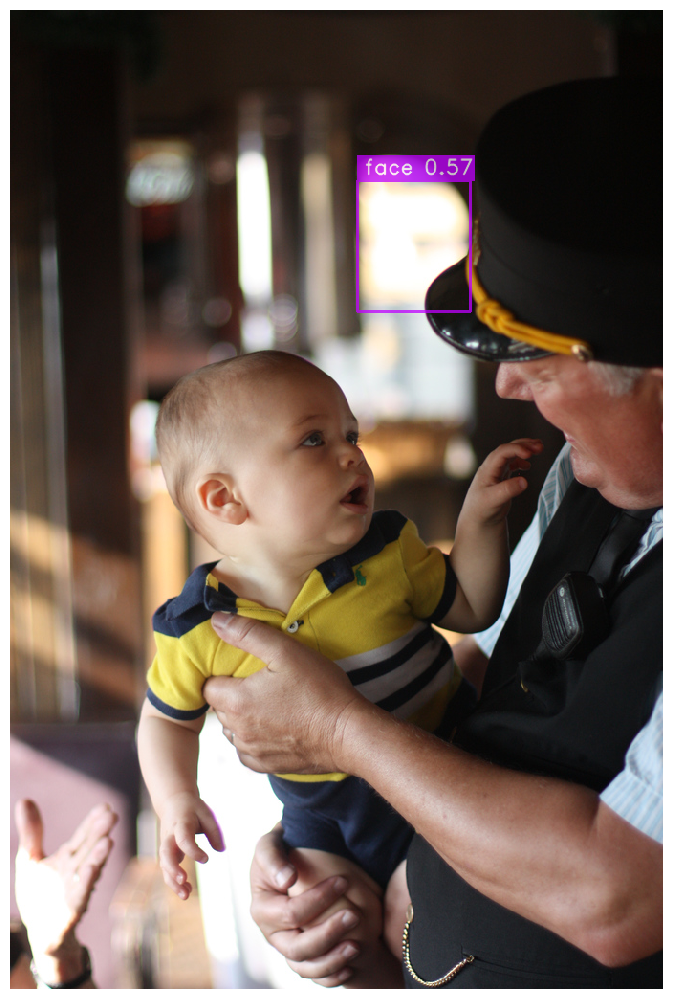

In [38]:
img_1 = "/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/images/val/5a02a982ebece444.jpg"
best_model.predict(img_1).show()


[2023-11-28 18:43:56] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


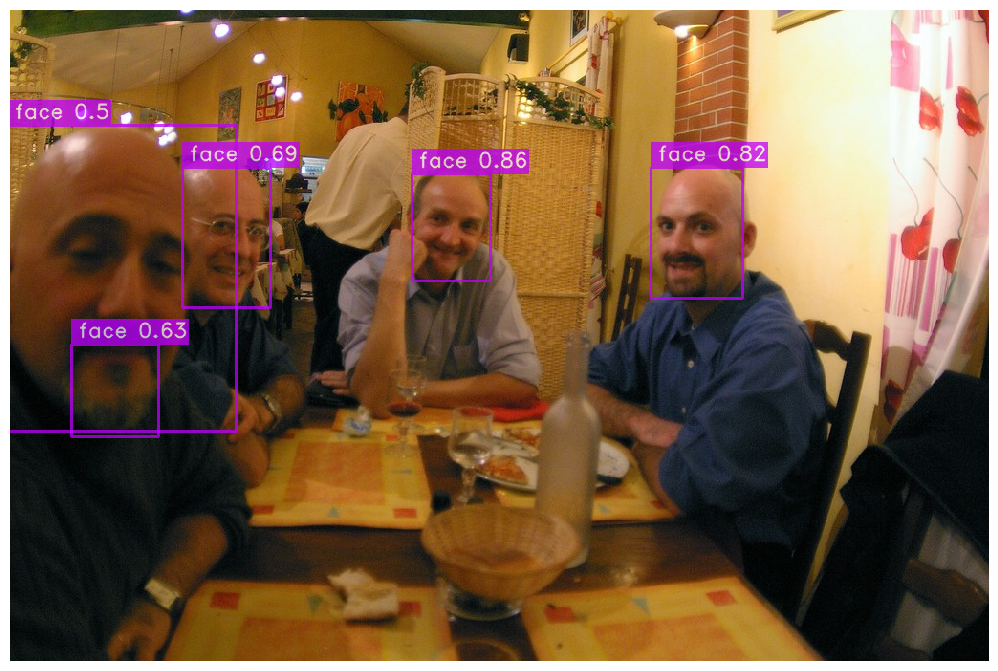

In [39]:
img_2 = "/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/images/val/4fb5e4e5d4588fc0.jpg"
best_model.predict(img_2).show()

[2023-11-28 18:44:31] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


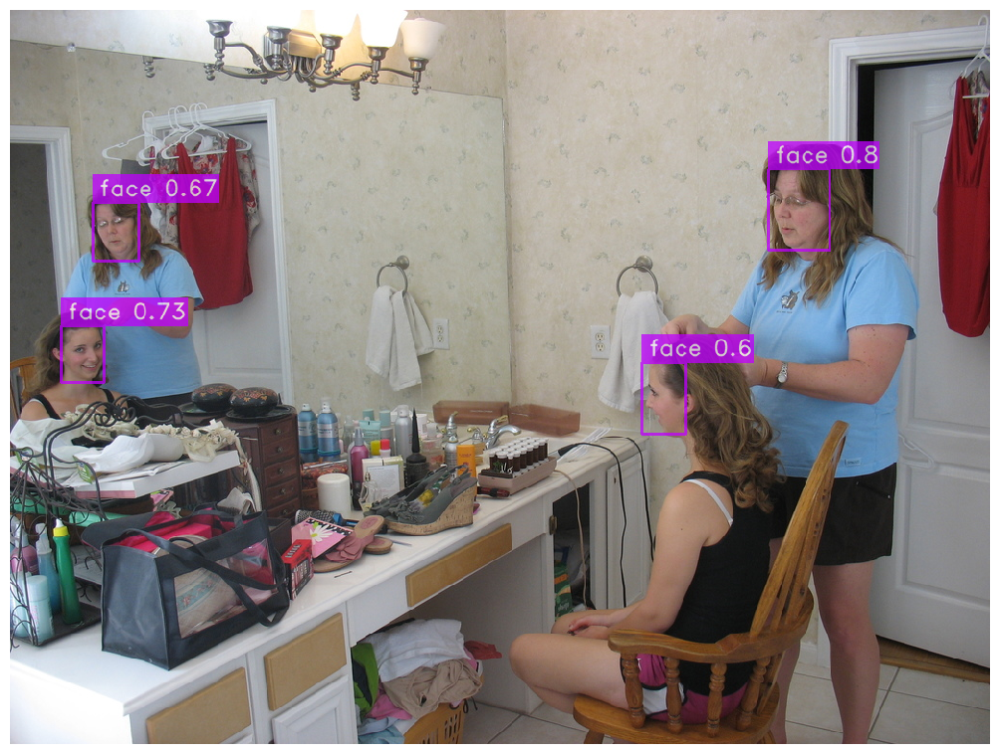

In [40]:
img_4 = "/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/images/val/5ad0d0669d470598.jpg"
best_model.predict(img_4).show()

[2023-11-28 18:44:59] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


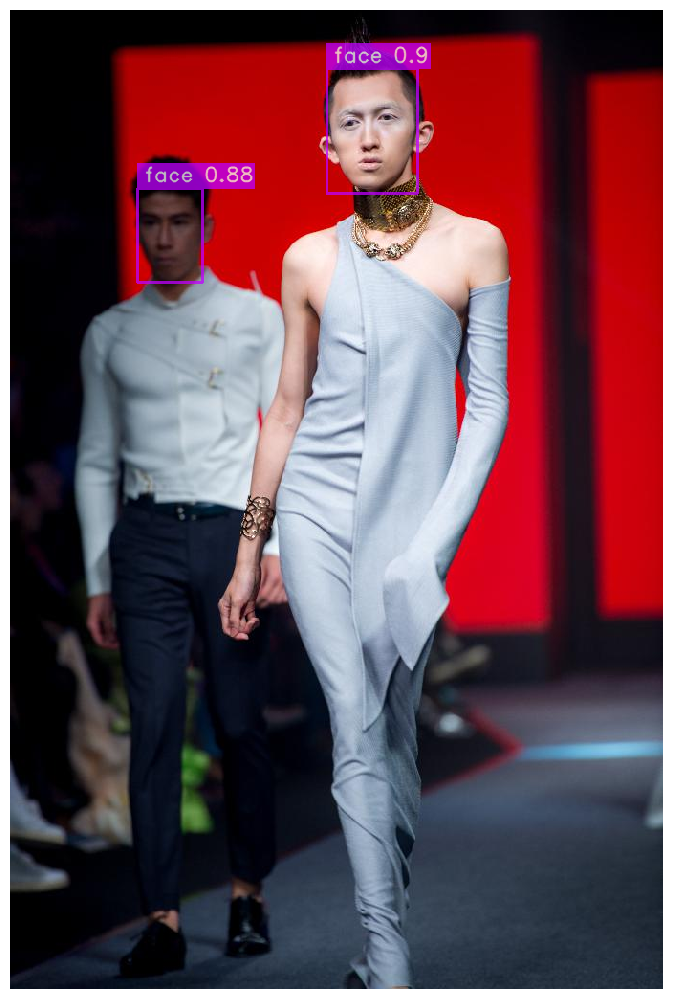

In [41]:
img_5 = "/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/images/val/6fdd7c067aeb9952.jpg"
best_model.predict(img_5).show()

[2023-11-28 18:45:19] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


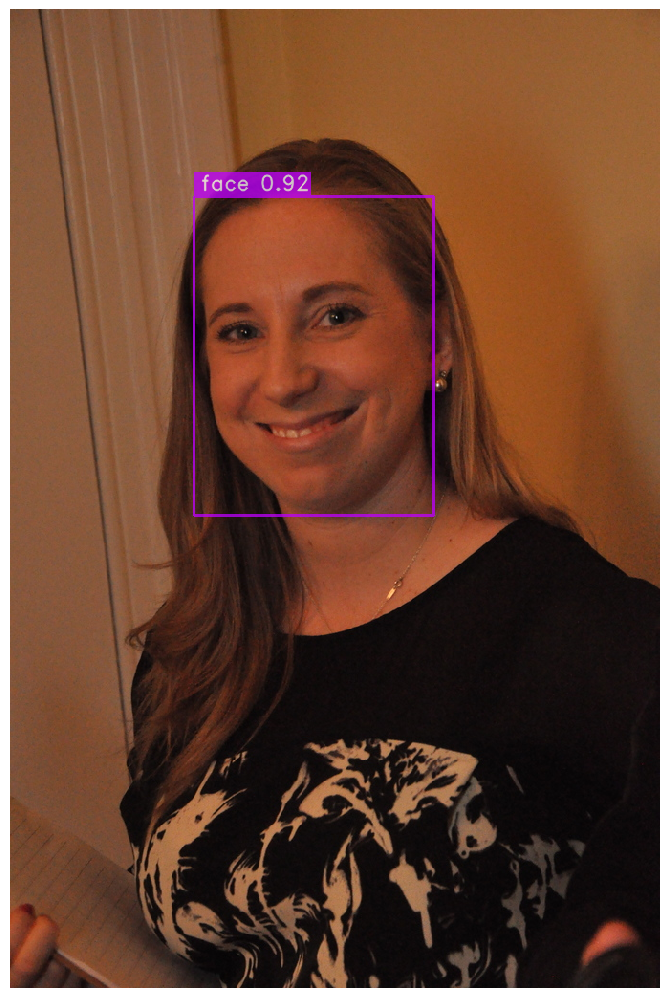

In [42]:
img_6 = "/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/images/val/9feaa97f0a92eef6.jpg"
best_model.predict(img_6).show()


[2023-11-28 18:45:52] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


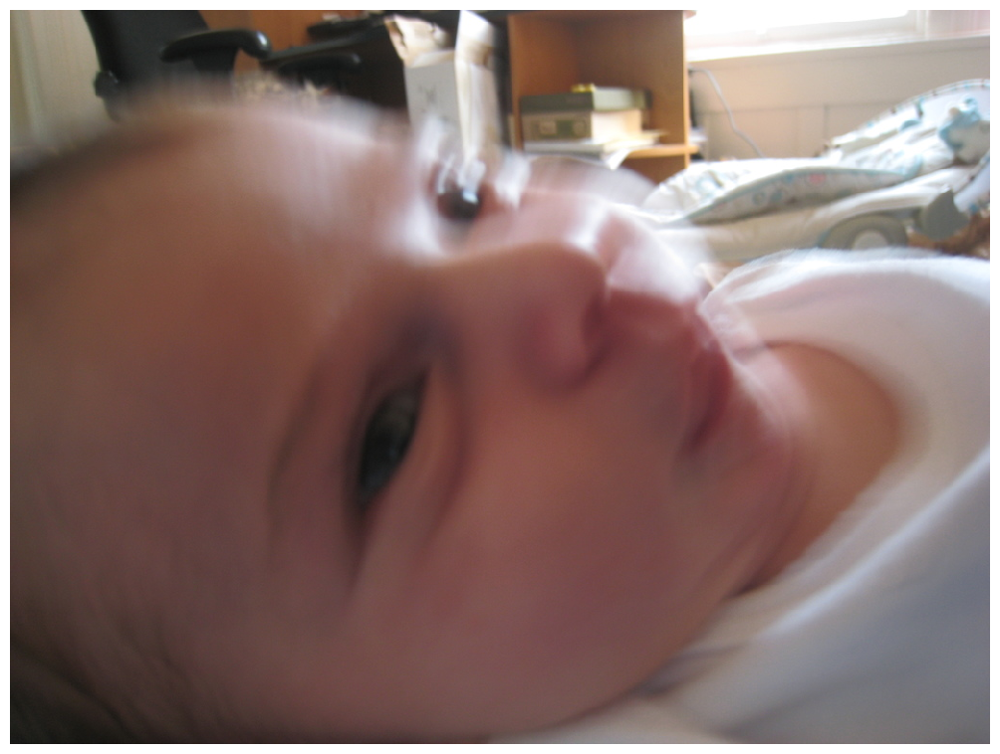

In [43]:
img_7 = "/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/images/val/9fac74937dfdf802.jpg"
best_model.predict(img_7).show()


[2023-11-28 18:46:36] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


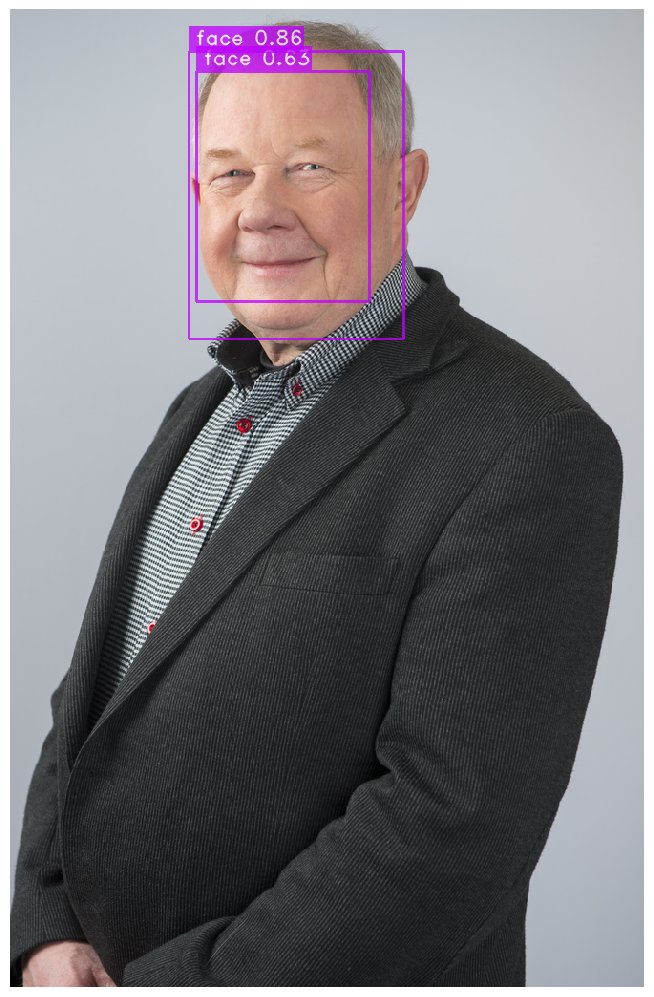

In [44]:
img_8 = "/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/images/val/8ec3aa5cae0009ab.jpg"
best_model.predict(img_8).show()

[2023-11-28 18:47:43] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


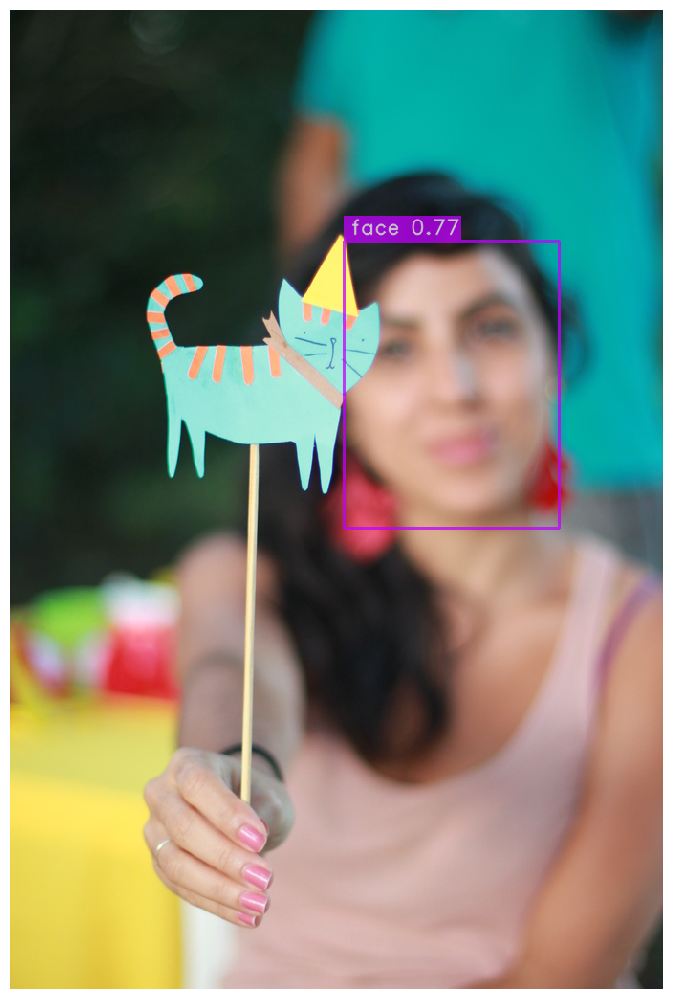

In [45]:
img_9 = "/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/images/val/5f208999d992a82a.jpg"
best_model.predict(img_9).show()

[2023-11-28 18:48:05] INFO - pipelines.py - Fusing some of the model's layers. If this takes too much memory, you can deactivate it by setting `fuse_model=False`


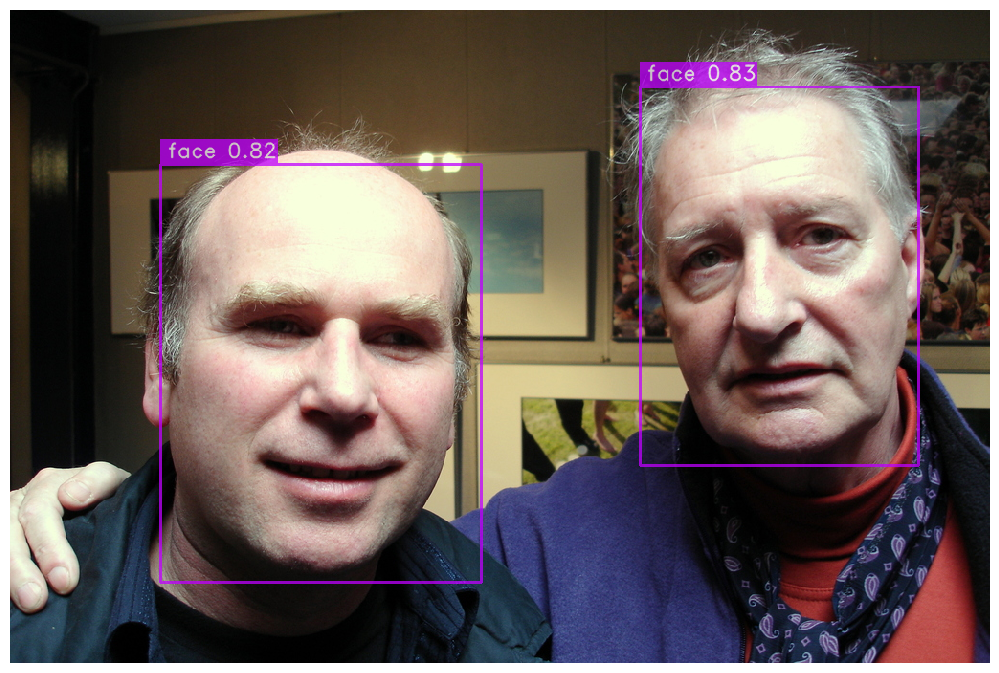

In [46]:
img_10 = "/content/drive/MyDrive/avantiDataReduc/kaggle/input/face-detection-dataset/images/val/0007ad5c6245a41d.jpg"
best_model.predict(img_10).show()